<a href="https://colab.research.google.com/github/Barbie2401/images.msc/blob/main/Reconocimiento_imagen_MSC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Reconocimiento de imagenes de Celulas madres mesenquimales

In [1]:
import numpy as np
import matplotlib.pyplot as plt 
import os 
import datetime
from PIL import Image 
import tensorflow as tf 
import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from keras.preprocessing.image import ImageDataGenerator, load_img
from sklearn.metrics import classification_report, confusion_matrix, classification_report



In [2]:
%load_ext tensorboard

In [3]:
tf.test.gpu_device_name () # Verificamos que Tensorflow está utilizando una GPU

'/device:GPU:0'

In [6]:
from google.colab import files  
uploaded = files.upload()  #Subimos el archibo en Zip

Saving MSC3.zip to MSC3.zip


In [7]:
!pwd #Vemos donde quedó guardado el archuvo que subimos

/content


In [8]:
import zipfile
import io
data = zipfile.ZipFile(io.BytesIO(uploaded['MSC3.zip']) , 'r')
data.extractall() #Extraemos los archivos

In [9]:
# Configuramos las rutas de los datos 
train_folder= 'train/'
val_folder = 'val/'
test_folder = 'test/'
train_n = train_folder+'4/'
train_p = train_folder+'1/'

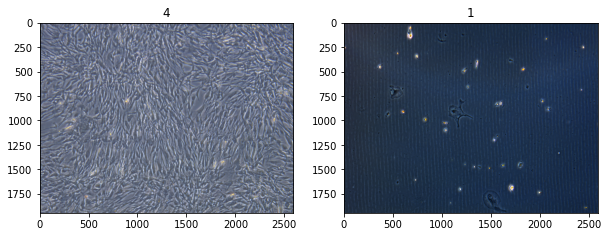

In [10]:
# Miramos un par de radiografías normales y patólogicas al azar

rand_norm= np.random.randint (0,len(os.listdir(train_n)))
norm_pic = os.listdir(train_n)[rand_norm]

norm_pic_address = train_n+norm_pic

rand_p = np.random.randint(0,len(os.listdir(train_p)))

sic_pic =  os.listdir(train_p)[rand_norm]
sic_address = train_p+sic_pic

norm_load = Image.open(norm_pic_address)
sic_load = Image.open(sic_address)

f = plt.figure(figsize= (10,6))
a1 = f.add_subplot(1,2,1)
img_plot = plt.imshow(norm_load, cmap="gray")
a1.set_title('4')

a2 = f.add_subplot(1, 2, 2)
img_plot = plt.imshow(sic_load, cmap="gray")
a2.set_title('1')

plt.show()

In [11]:
##QUEDE AQUI, Estpo tengo que revisar
# Configuramos el generador de datos que utilizará nuestra red

batch_size = 32

# Queremos aumentar los datos del conjunto de prueba al generar imágenes sintéticas distorisionadas
train_datagen = ImageDataGenerator(rescale = 1./255, # A las imágenes se les normaliza el brillo
                                   shear_range = 0.2, # Distorsionamos las imágenes
                                   zoom_range = 0.2, # Acercamos las imágenes
                                   horizontal_flip = True) # Volteamos horizontalmente las imágenes

test_datagen = ImageDataGenerator(rescale = 1./255)

training_set = train_datagen.flow_from_directory(train_folder,
                                                 target_size = (64, 64), # Las imágenes se redimensionan a 64*64
                                                 batch_size = batch_size,
                                                 class_mode = 'binary', #Bynary: 2 clases (Normal y neumonia)
                                                 color_mode="grayscale") # Sólo utilizamos el canal de brillo

val_set = test_datagen.flow_from_directory(val_folder,
                                            target_size=(64, 64),
                                            batch_size=batch_size,
                                            class_mode='binary',
                                            shuffle = False,
                                            color_mode="grayscale")

test_set = test_datagen.flow_from_directory(test_folder,
                                            target_size = (64, 64),
                                            batch_size = batch_size,
                                            class_mode = 'binary',
                                            shuffle = False,
                                            color_mode="grayscale")

Found 91 images belonging to 2 classes.
Found 96 images belonging to 2 classes.
Found 96 images belonging to 2 classes.


Modelamiento

In [91]:
# Construimos la arquitectura de la red neuronal

cnn = Sequential()

cnn.add(Conv2D(32, (3, 3), activation="relu", input_shape=(64, 64, 1))) # Capa de convolución

cnn.add(MaxPooling2D(pool_size = (2, 2)))

cnn.add(Conv2D(32, (3, 3), activation="relu"))

cnn.add(MaxPooling2D(pool_size = (2, 2)))

cnn.add(Flatten())

cnn.add(Dense(activation = 'relu', units = 128))
cnn.add(Dense(activation = 'sigmoid', units = 1))

cnn.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = ['accuracy']) # Creamos la arquitectura

In [92]:
# Verificamos la arquitectura
cnn.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_10 (Conv2D)           (None, 62, 62, 32)        320       
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 31, 31, 32)        0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 29, 29, 32)        9248      
_________________________________________________________________
max_pooling2d_11 (MaxPooling (None, 14, 14, 32)        0         
_________________________________________________________________
flatten_5 (Flatten)          (None, 6272)              0         
_________________________________________________________________
dense_10 (Dense)             (None, 128)               802944    
_________________________________________________________________
dense_11 (Dense)             (None, 1)                

In [93]:
logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [102]:
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 3202), started 0:14:46 ago. (Use '!kill 3202' to kill it.)

<IPython.core.display.Javascript object>

In [100]:
# Entrenamos la red neuronal

cnn_history = cnn.fit(training_set,
                         epochs = 20, # Entrenamos la red por 20 épocas
                         validation_data = val_set,
                         callbacks=[tensorboard_callback])

Epoch 1/20
3/3 [==============================] - 25s 11s/step - loss: 0.2029 - accuracy: 0.9231 - val_loss: 0.6664 - val_accuracy: 0.7083
Epoch 2/20
3/3 [==============================] - 22s 9s/step - loss: 0.1416 - accuracy: 0.9890 - val_loss: 0.1617 - val_accuracy: 0.9792
Epoch 3/20
3/3 [==============================] - 21s 9s/step - loss: 0.2484 - accuracy: 0.8901 - val_loss: 0.8583 - val_accuracy: 0.7083
Epoch 4/20
3/3 [==============================] - 21s 9s/step - loss: 0.1711 - accuracy: 0.9341 - val_loss: 0.4734 - val_accuracy: 0.8333
Epoch 5/20
3/3 [==============================] - 21s 9s/step - loss: 0.1496 - accuracy: 0.9451 - val_loss: 0.4077 - val_accuracy: 0.8333
Epoch 6/20
3/3 [==============================] - 21s 9s/step - loss: 0.1182 - accuracy: 0.9560 - val_loss: 0.8567 - val_accuracy: 0.7083
Epoch 7/20
3/3 [==============================] - 21s 9s/step - loss: 0.1165 - accuracy: 0.9780 - val_loss: 0.4883 - val_accuracy: 0.7917
Epoch 8/20
3/3 [=================

In [103]:
predictions = cnn.predict(test_set, verbose = 1) > 0.5 # Predecimos sobre el conjunto de prueba

3/3 [==============================] - 11s 4s/step


In [104]:
confusion_matrix(test_set.classes, predictions) # Matriz de confusión

array([[ 4, 40],
       [ 0, 52]])

In [105]:
print(classification_report(test_set.classes, predictions)) # Resumen del rendimiento del modelo

              precision    recall  f1-score   support

           0       1.00      0.09      0.17        44
           1       0.57      1.00      0.72        52

    accuracy                           0.58        96
   macro avg       0.78      0.55      0.44        96
weighted avg       0.76      0.58      0.47        96



# Sección nueva

**Exploración**

Para entender cómo funciona la red neuronal, visualizaremos las salidas de cada una de las capas.

In [37]:
def image_loader(path):
  image_location = path # Seleccionamos una imagen del conjunto de prueba
  img =Image.open(image_location)
  # Cargamos la imagen
  img_resized = tf.keras.preprocessing.image.load_img(
      image_location,
      target_size = (64, 64), # Debemos redimensionar la imagen para poder ser ingresada a la red
      color_mode="grayscale"
  )
  # Transformamos la imagen en un arreglo de las dimensiones que recibe la red
  img_array = tf.keras.preprocessing.image.img_to_array(
      img_resized
  )
  img_array = np.expand_dims(
      img_array,
      axis=0
  )
  return img, img_resized, img_array

In [38]:
def get_activations(model,img_array):
  # Creamos un modelo que entrega los resultados después de cada capa
  layer_outputs = [layer.output for layer in model.layers]
  layer_names = [layer.name for layer in model.layers]
  activation_model = tf.keras.models.Model(inputs=model.input, outputs=layer_outputs)
  activations = activation_model.predict(img_array)
  activations = list(zip(layer_names,activations))
  return activations

In [39]:
# Esta función grafica los resultados de los filtros de la capa de convolución
def plot_conv_layer_result(activations,j):
  fig, axs = plt.subplots(
      nrows=4,
      ncols=8,
      figsize=(15,8)
  )
  fig.suptitle(activations[j][0])
  for i,ax in enumerate(axs.ravel()):
      ax.imshow(activations[j][1][0,:,:,i], cmap="viridis")
      ax.axis("off")
  plt.show()

In [40]:
# Con esto graficamos los arreglos unidimensionales
def plot_1d_layer_result(activations,j):
  values = activations[j][1][0,:]
  plt.bar(
      range(len(values)),
      values
  )
  plt.title(activations[j][0])
  plt.show()

## Imagenes de MSC

In [51]:
 MSC4_img, MSC4_img_resized, MSC4_img_array = image_loader("/content/test/4/2007-3.jpg")  

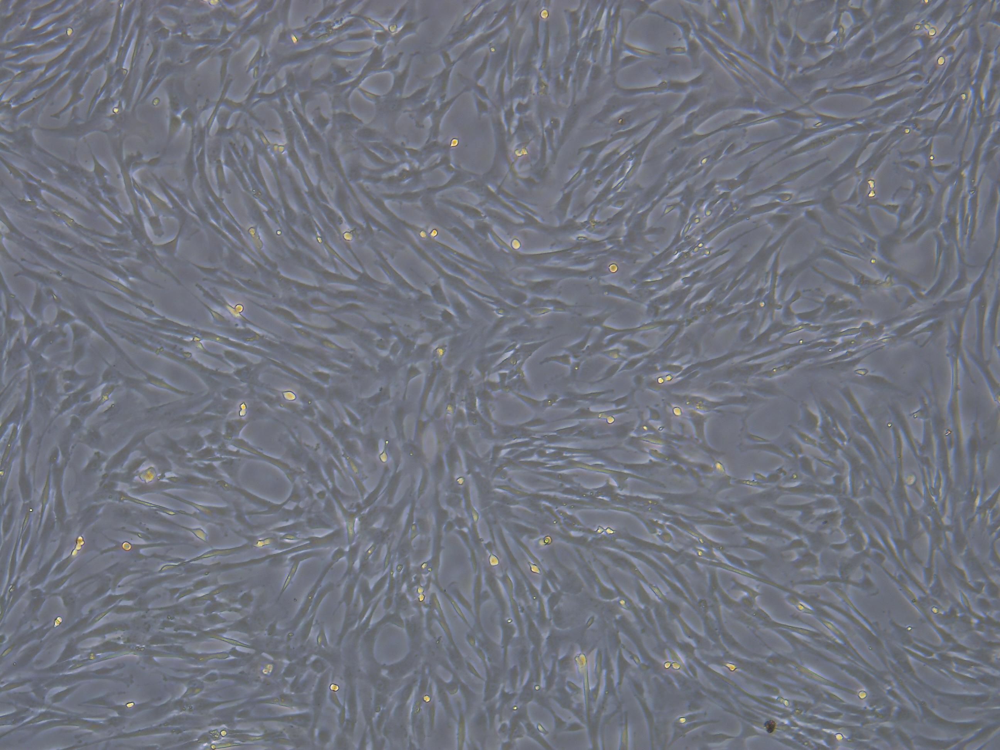

In [52]:
MSC4_img # Asi se ve la imagen original

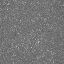

In [53]:
MSC4_img_resized # Esta es la imagen con las dimensiones correctas para ingresarla a la red

In [54]:
MSC4_img_array.shape # Esta es la dimensión del arreglo numérico que se ingresará a la red

(1, 64, 64, 1)

In [55]:
# Predecimos sobre el arreglo
cnn.predict(MSC4_img_array)

array([[1.]], dtype=float32)

In [56]:
MSC4_activations = get_activations(cnn,MSC4_img_array)

## En el siguiente gráfico vemos las 32 imágenes correspondientes a la salida de cada uno de los filtros de la capa de convolución.

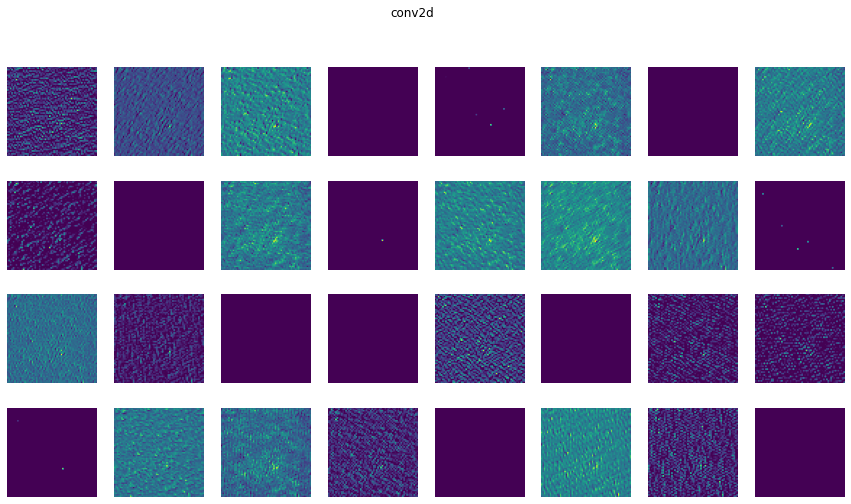

In [57]:
plot_conv_layer_result(MSC4_activations,0)

En el siguiente gráfico observamos como la capa de max-pooling reduce la resolución de la imagen.

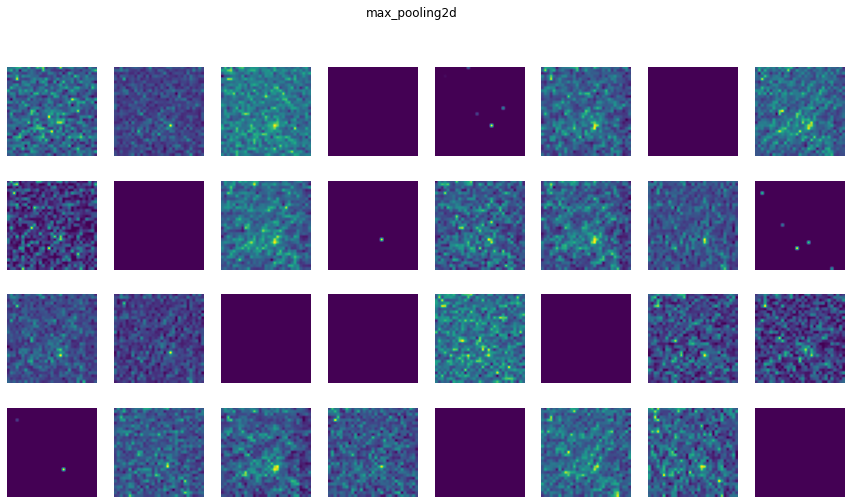

In [58]:
plot_conv_layer_result(MSC4_activations,1)

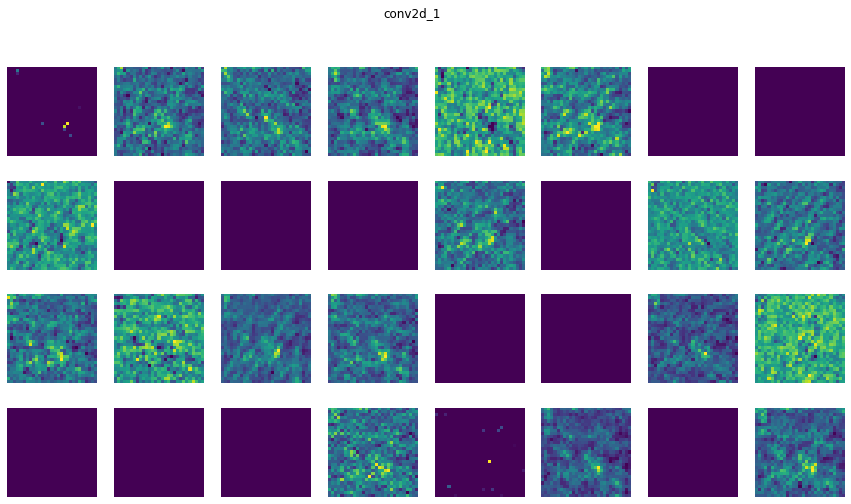

In [59]:
plot_conv_layer_result(MSC4_activations,2)

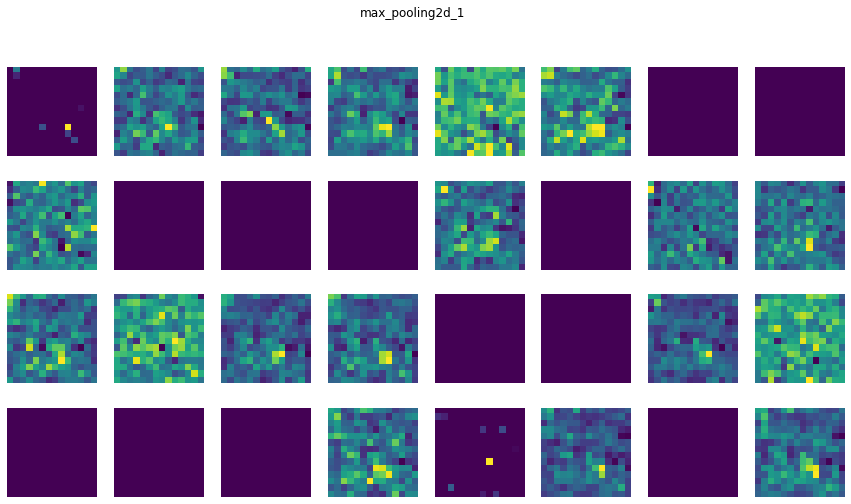

In [60]:
plot_conv_layer_result(MSC4_activations,3)

Después del segundo max-pooling tenemos sólo arreglos unidimensionales, este primer resultado son todos los elementos del resultado anterior concatenados en un sólo arreglo.

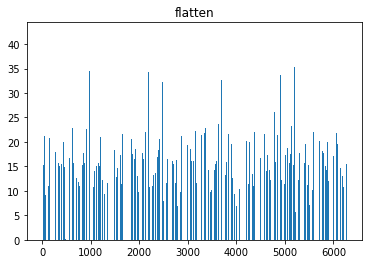

In [61]:
plot_1d_layer_result(MSC4_activations,4)

Con la capa densa reducimos el número de elementos del arreglo anterior.

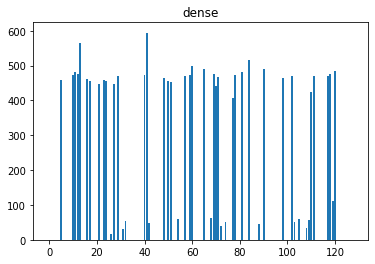

In [62]:
plot_1d_layer_result(MSC4_activations,5)

La última capa tiene sólo 1 neurona correspondiente a la clasificación final de la red



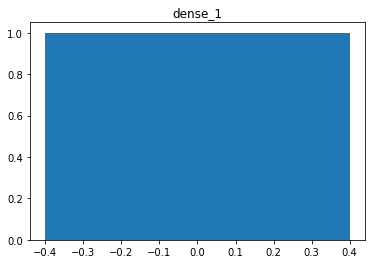

In [64]:
plot_1d_layer_result(MSC4_activations,6)